Magnification of a single png image
=
Set parameters and choose image in last cell


In [2]:
import imageio
import math
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import norm
import scipy.optimize as optimize
import scipy.fftpack as fftpack
%matplotlib inline

In [3]:
# image is numpy array 
def fix_rotation(image):
    return np.rot90(image, k=3)

In [4]:
def crop_center(img, cropx, cropy):
    y,x = img.shape
    startx = x//2-(cropx//2)
    starty = y//2-(cropy//2) 
    return img[starty:starty+cropy,startx:startx+cropx]

In [5]:
# takes in image name and bin size, returns binned image (numpy array)
def bin_image(im, bin_size):
    shape = im.shape
    while (len(im) % bin_size) != 0:
        im = im[:((len(im) // bin_size)*bin_size)]
    new_shape = (im.shape[0] // bin_size, im.shape[1])
    shape = (new_shape[0], im.shape[0] // new_shape[0],
             new_shape[1], im.shape[1] // new_shape[1])
    new_image = im.reshape(shape).mean(-1).mean(1)
    return new_image

In [6]:
# takes in a row of pixels and outputs a list of the transition pixels
def get_transitions(row):
    row = row.squeeze()
    threshold = (row.max(axis=0) + row.min(axis=0)) / 2.
    transitions = np.diff(row > threshold, prepend=False)
    transitions = np.argwhere(transitions)[1::2,0]
    transitions = transitions[1:-1]
    return transitions

In [7]:
# computes a list of strip lengths from the transitions indices 
# (computes the difference between adjacent entries in transitions list)
def strip_length(transitions):
    strip_lens = np.ediff1d(transitions) / 2
    return strip_lens

In [8]:
def mean_strip_width_array(image, bin_size):
    binned_image = bin_image(image, bin_size)
    return np.concatenate([strip_length(get_transitions(row))for row in binned_image], axis=0)

In [9]:
# implement magnification formula 
def magnification(pix_width, cam_pix_width, line_width):
    size_on_sensor = cam_pix_width * pix_width
    return size_on_sensor / line_width

In [10]:
def calc_mag_fit(image, cam_pix_width, line_width, plot_fits, plot_phases):
    im = image
    binned_image = bin_image(im, 8)
    mag_array = []
    amps = []
    phases = []
    frequencies = []
    amp_errs = []
    phase_errs = []
    freq_errs = []
    bad_fits = 0
    for row in binned_image:
        pi = np.pi
        b_mid = (row.max() + row.min()) / 2
        amp = (row.max() - row.min()) / 2
        row -= b_mid

        def sine(x, a1, a2, a3):
            return a1 * np.sin(a2 * x + a3)

        N = xmax = im.shape[1]
        xReal = np.linspace(0, xmax, N)

        yhat = fftpack.rfft(row)
        idx = (yhat**2).argmax()
        freqs = fftpack.rfftfreq(N, d = (xReal[1]-xReal[0])/(2*pi))
        frequency = freqs[idx]

        amplitude = row.max()
        guess = [amplitude, frequency, 0.]
        (amplitude, frequency, phase), pcov = optimize.curve_fit(
            sine, xReal, row, guess, maxfev=5000)
        
        errors = np.sqrt(np.diag(pcov))
        amp_errs.append(errors[0])
        freq_errs.append(errors[1])
        phase_errs.append(errors[2])
        
        num_pixels = pi*(1/frequency) # pi because we only want one strip width
        
        amps.append(amplitude)
        phases.append(phase)
        frequencies.append(frequency)
        
        mag = magnification(num_pixels, cam_pix_width, line_width)
        
        if plot_fits:
            plt.figure(figsize = (15, 5))
            xx = xReal
            yy = sine(xx, amplitude, frequency, phase)
            plt.plot(xReal, row, 'r', linewidth = 1, label = 'Data')
            plt.plot(xx, yy , linewidth = 1, label = 'Fit')
            plt.legend()
            plt.show()

        mag_array.append(mag)
        
    mag_array = np.array(mag_array)
    if plot_phases:
        plt.plot(phases)
        plt.show()
    return mag_array

In [11]:
def calc_mag(image, bin_size, pixel_size, linesmm, plot_histogram, plot_fits, plot_phases):
    line_size = 1 / (linesmm * 2)
    hist_bins = 100
    im = imageio.imread(image, as_gray=True)
    plt.imshow(im, cmap='gray', aspect='auto')
    plt.show(block=False)
    rotate = int(input("1 to rotate image, 0 to keep the same: "))
    if rotate == 1: 
        im = fix_rotation(im)
    fig = plt.figure(frameon=False)
    plt.imshow(im, cmap='gray', aspect='auto')
    plt.show(block=False)
    crop_factor = 0
    while (crop_factor != 1):
        crop_factor = float(input("Enter crop factor (1 for no crop): "))
        im = crop_center(im, math.floor(im.shape[1]*crop_factor), math.floor(im.shape[0]*crop_factor))        
        plt.imshow(im, cmap='gray')
        plt.show(block=False)
    mode = int(input("1 for thresholding, 0 for curve fit: "))
    if mode == 1:
        strip_array = mean_strip_width_array(im, bin_size)
        mag_array = magnification(strip_array, pixel_size, line_size)
        mean, std = norm.fit(mag_array)
        if plot_histogram:
            x = np.linspace(mag_array.min(), mag_array.max(), hist_bins)
            plt.hist(mag_array, bins=x)
            plt.axvline(mean, color='red')
            plt.show()
        mean,std=norm.fit(mag_array)
        print(str(mean) + " +/- " + str(std))
    else:
        mag_array = calc_mag_fit(im, pixel_size, line_size, plot_fits, plot_phases)
        mean, std = norm.fit(mag_array)
        if plot_histogram:
            x = np.linspace(mag_array.min(), mag_array.max(), hist_bins)
            plt.hist(mag_array, bins=x)
            plt.axvline(mean, color='red')
            plt.show()
        print("Magnification:")
        print(str(mean) + " +/- " + str(std))

/tmp/ipykernel_40036/2593390713.py:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  im = imageio.imread(image, as_gray=True)


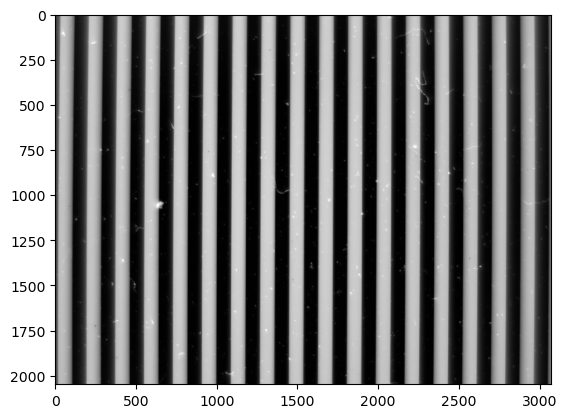

1 to rotate image, 0 to keep the same:  0


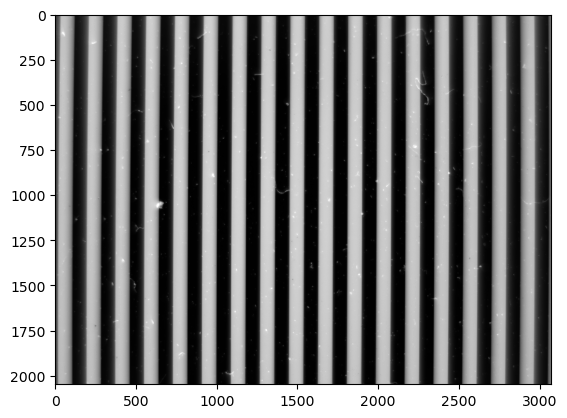

Enter crop factor (1 for no crop):  1


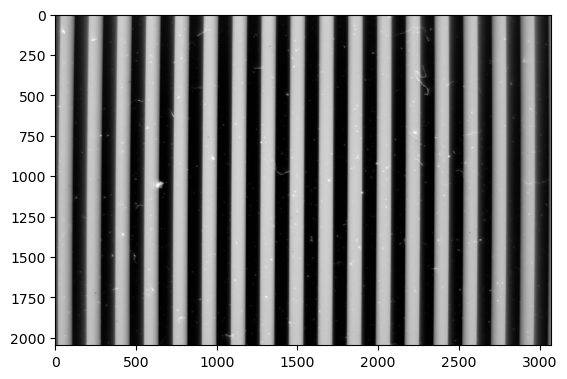

1 for thresholding, 0 for curve fit:  0


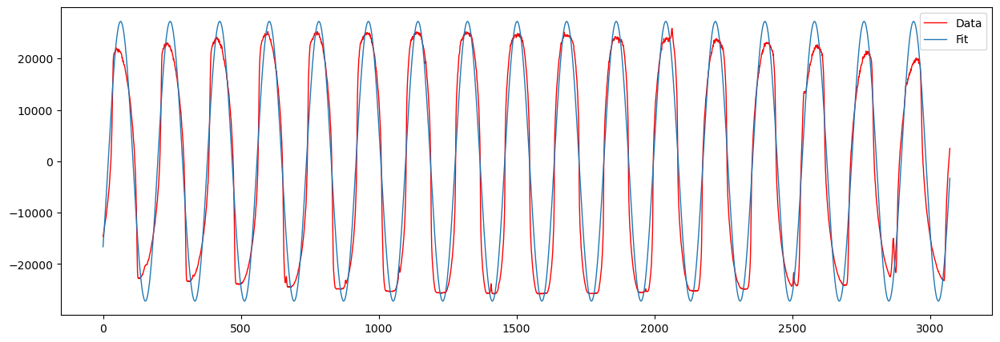

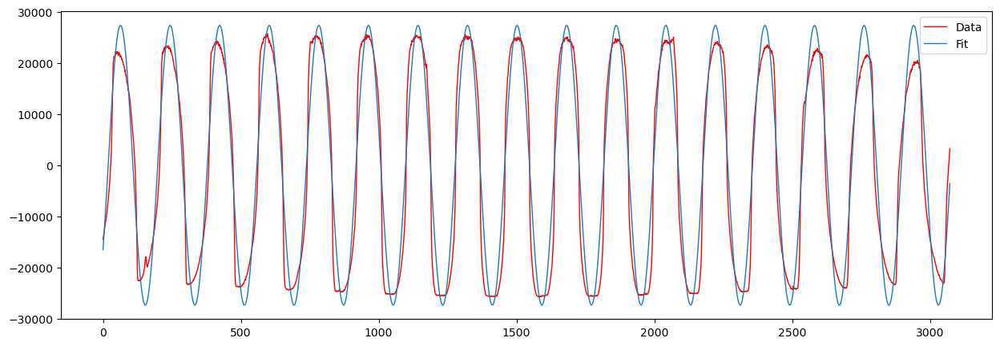

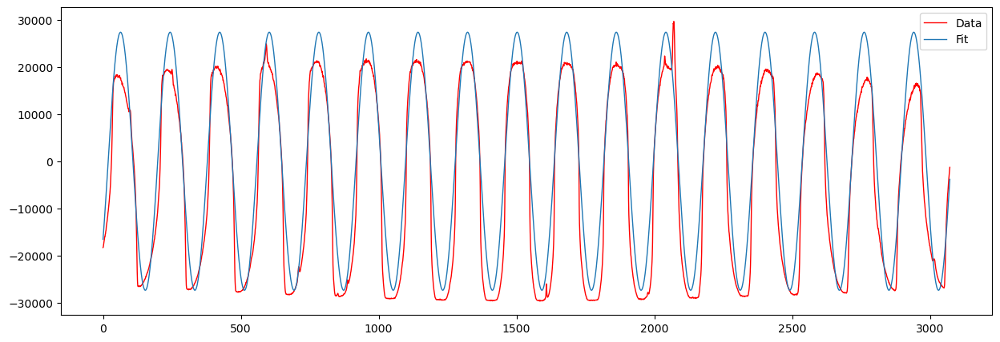

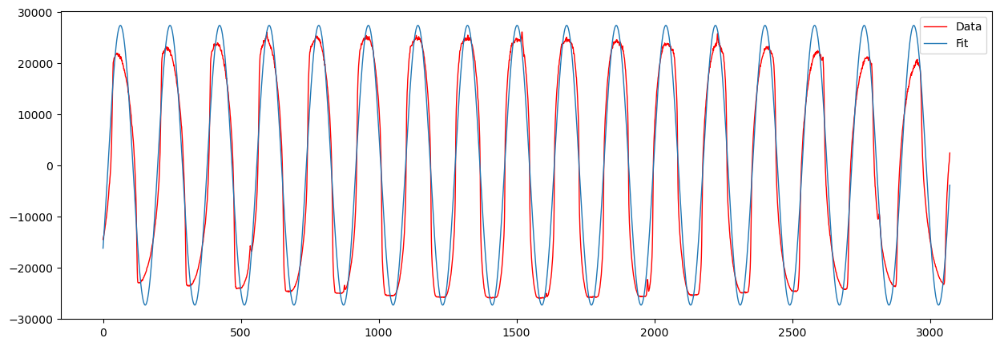

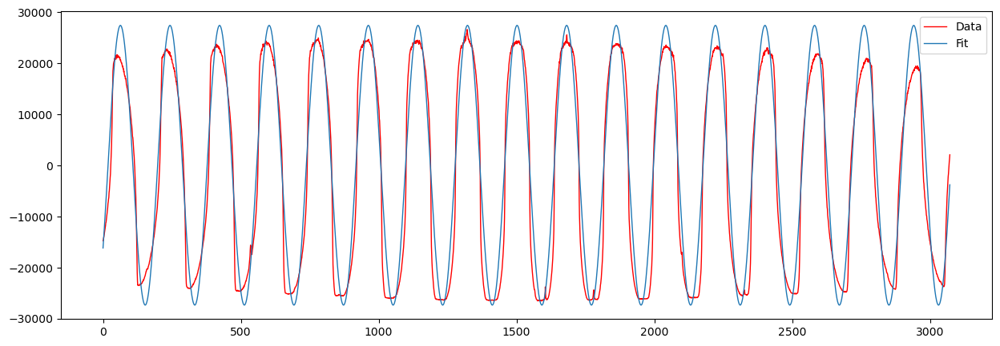

...

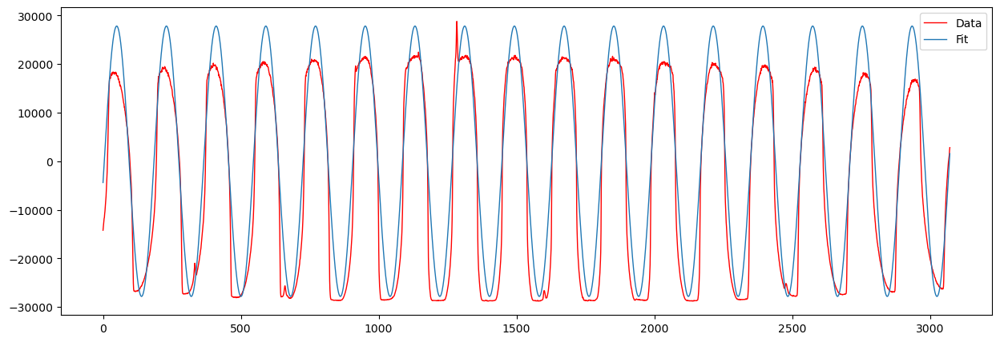

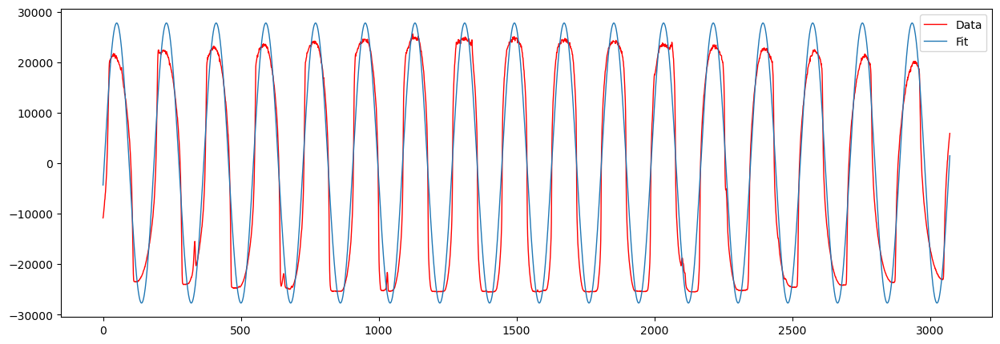

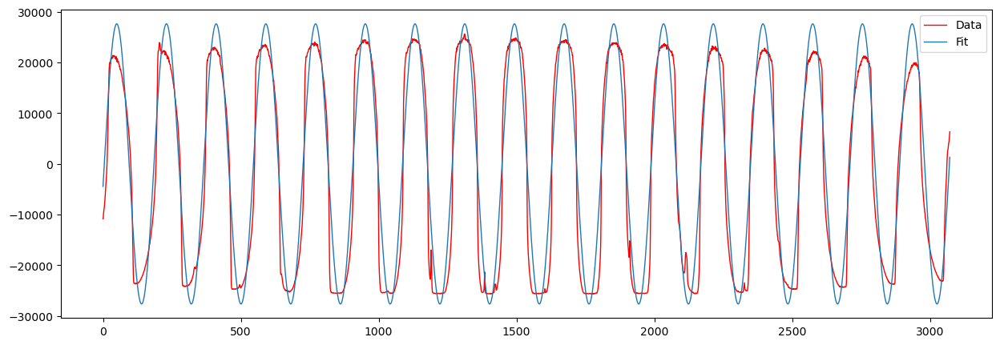

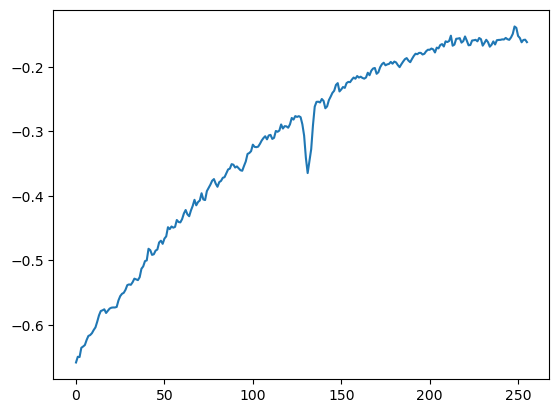

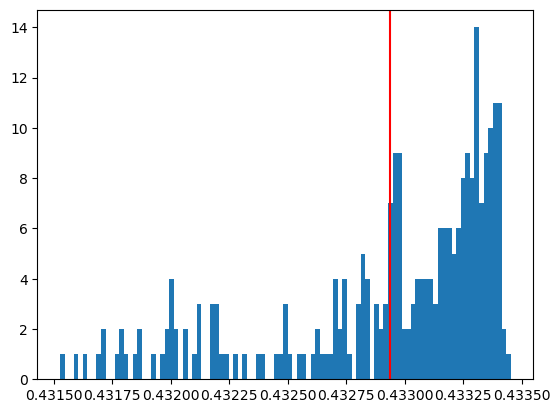

Magnification:
0.4329347185172466 +/- 0.0004730400681097764


In [20]:
bin_size = 2048
pixel_width = .0024 # in mm
lines_mm = 1 # lines per mm
# plot_histogram, plot_fits, plot_phases are booleans 

data_dir = "/home/sanha/immanuel/research/magis/data/DIS/lab/20230125"
file_list = [
    # "20220125_mag_25mm_f1p4_WD58mm_001.png",
    "20220125_mag_25mm_f1p4_WD60mm_001.png",
    # "20220125_mag_25mm_f1p4_WD62mm_001.png",
    # "20220125_mag_25mm_f1p4_WD65mm_001.png"
]

for file in file_list:
    calc_mag(f"{data_dir}/{file}", bin_size, pixel_width, lines_mm, True, True, True)